In [1]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
from netCDF4 import Dataset, num2date, date2num
from datetime import datetime

#For Map
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
import matplotlib.ticker as mticker 
from matplotlib.patches import Rectangle

#Stuff for Meteorological calculations 
import wrf
import metpy.calc as mpcalc
from metpy.plots import SkewT
from metpy.units import units
from wrf import (to_np, interplevel, geo_bounds, getvar, smooth2d, get_cartopy, cartopy_xlim,
                 cartopy_ylim, latlon_coords)

#Next thing: we need to know open up every file in the Dean Directory and loop through them!
import glob
import pandas as pd

In [2]:
#Create a list of the location of our files:

Dean_adjusted = sorted(glob.glob("/scratch/legetker/wdm_ctrl_run/wrfout_d02*"))

print(Dean_adjusted)

['/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_00:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_01:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_02:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_03:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_04:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_05:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_06:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_07:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_08:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_09:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_10:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_11:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_12:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_13:00:00', '/scratch/legetker/wdm_ctrl_run/wrfout_d02_1998-05-30_14:00:00', '/scratch/legetker/wdm_c

In [3]:
#dataproj = ccrs.PlateCarree(central_longitude=-160)

def create_map_background():
    dataproj = ccrs.PlateCarree(central_longitude=-160)
    fig= plt.figure(figsize=(64, 20))
    ax = plt.subplot(111, projection=dataproj)
    ax.set_extent([180, -180, -82, 82],ccrs.PlateCarree())  #Adjusted these 4 to change your bounds, West, East, South, North
    ax.coastlines('50m', linewidth=1.5)
    ax.add_feature(cfeature.STATES, linewidth=1.0)
    ax.add_feature(cfeature.BORDERS, linewidth=1.0)
    gl = ax.gridlines(color='gray',alpha=0.5,draw_labels=True) 
    gl.xlabels_top, gl.ylabels_right = False, False
    gl.xlabel_style, gl.ylabel_style = {'fontsize': 16}, {'fontsize': 16}
    gl.xlocator = mticker.FixedLocator([380])
    gl.ylocator = mticker.FixedLocator([-90,-80,-60,-40,-20,0, 20, 40, 60, 80, 90])
    gl.xformatter = LongitudeFormatter(zero_direction_label=True)
    gl.yformatter = LatitudeFormatter()
    ax.xaxis.set_major_formatter(gl.xformatter)
    ax.yaxis.set_major_formatter(gl.yformatter)
    ax.stock_img()
    return fig, ax

In [6]:
#Next, find the vertexes of the square we are interested in analyzing
lat_lon_center_of_square = [43, -87]           #Lat, Lon cooridante of cetner of square we are interested in
X_Y_Sounding_Center = []

#now we need to get the x_y points of each lat longitude coordinate
for i in range(len(Dean_adjusted)):
    file = Dean_adjusted[i]
    #    print(file)
    wrfin = Dataset(str(file))
    x_ycenter = wrf.ll_to_xy(wrfin, lat_lon_center_of_square[0], lat_lon_center_of_square[1])
    X_Y_Sounding_Center.append(x_ycenter)
#X_Y_Sounding_Center

/opt/tljh/user/envs/MEA443/lib/python3.11/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/opt/tljh/user/envs/MEA443/lib/python3.11/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings.warn('The .ylabels_right attribute is deprecated. Please '
/opt/tljh/user/envs/MEA443/lib/python3.11/site-packages/cartopy/mpl/gridliner.py:451: UserWarning: The .xlabels_top attribute is deprecated. Please use .top_labels to toggle visibility instead.
  warnings.warn('The .xlabels_top attribute is deprecated. Please '
/opt/tljh/user/envs/MEA443/lib/python3.11/site-packages/cartopy/mpl/gridliner.py:487: UserWarning: The .ylabels_right attribute is deprecated. Please use .right_labels to toggle visibility instead.
  warnings

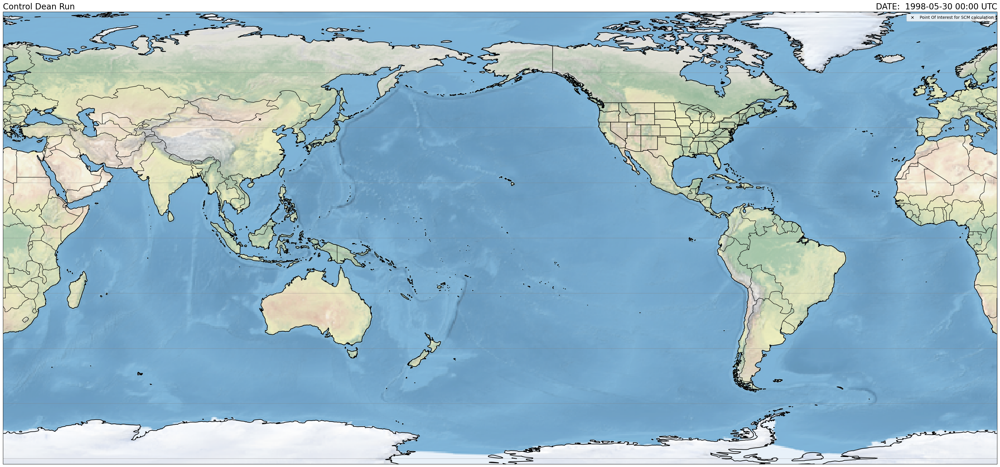

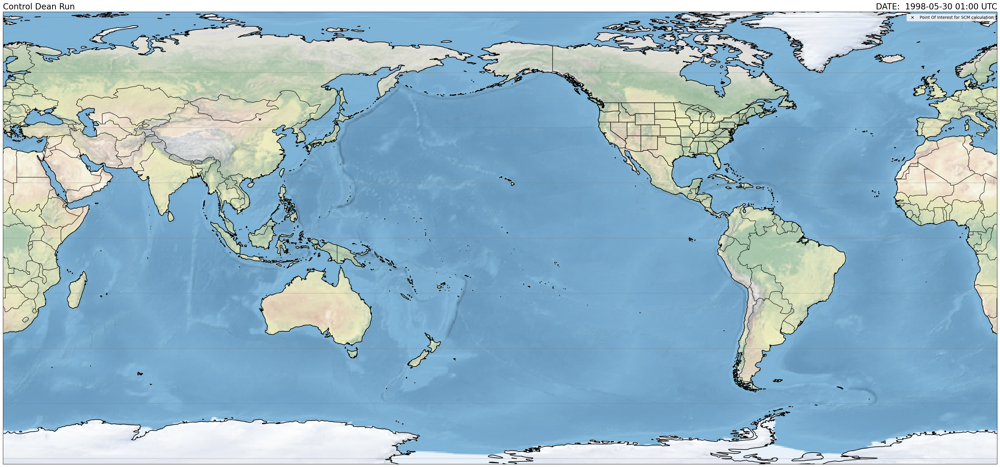

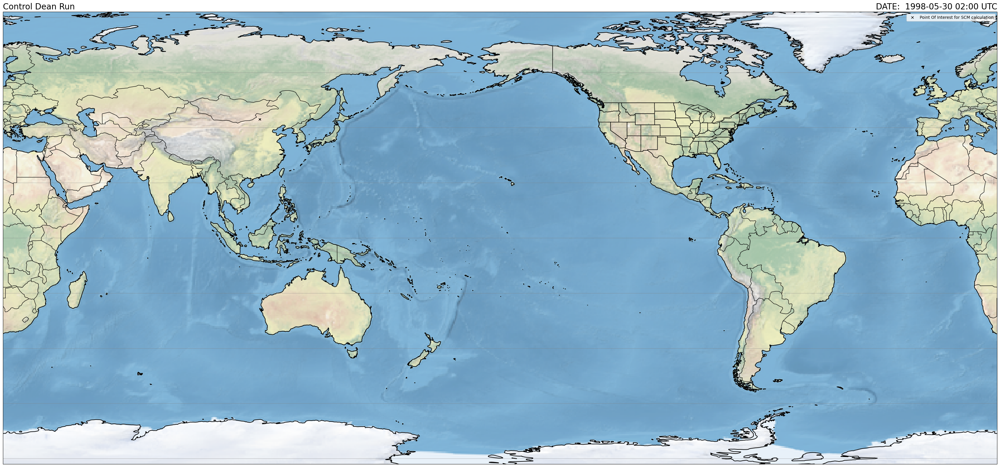

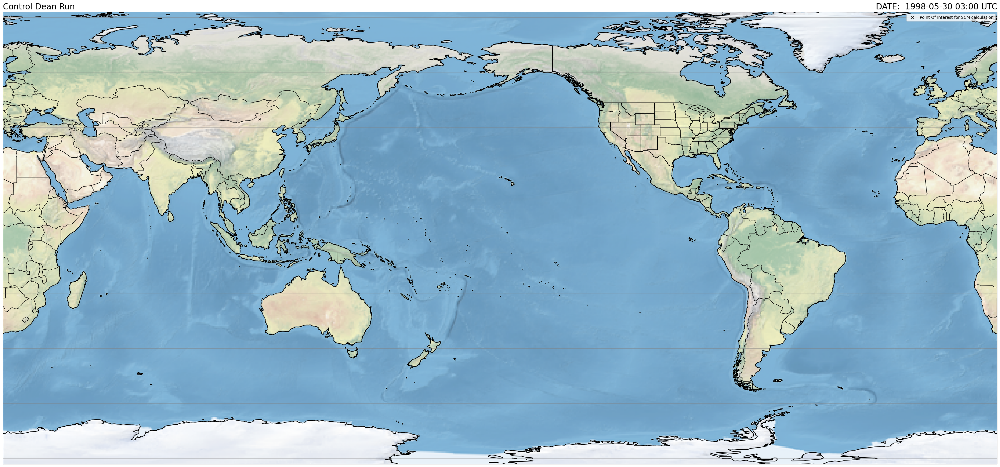

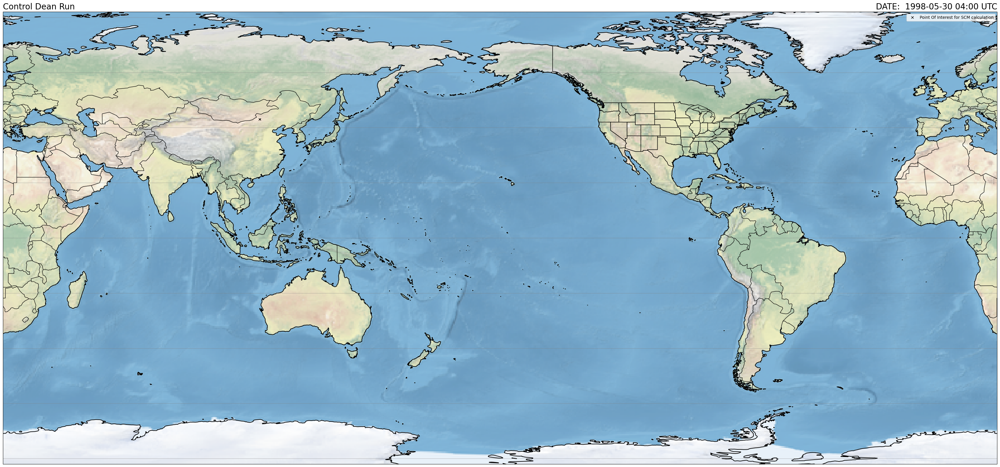

Exception ignored in: <function WeakKeyDictionary.__init__.<locals>.remove at 0x7f22f5524900>
Traceback (most recent call last):
  File "/opt/tljh/user/envs/MEA443/lib/python3.11/weakref.py", line 369, in remove
    def remove(k, selfref=ref(self)):

KeyboardInterrupt: 


Error in callback <function flush_figures at 0x7f22f20d2c00> (for post_execute):



KeyboardInterrupt



In [8]:
#constant Needed for Calcualtions
sigma = 5.67 * 10**-8 #Stefon-Boltzman Constant

#compare sounding sight to infared signature
for i in range(len(Dean_adjusted)):
    wrf_out_data = xr.open_dataset(Dean_adjusted[i])          #Open WRF_Out Data (I sorted glob glob my whole directory)
    wrf_out_OLR =  wrf_out_data['OLR'][0,:,:]
    wrf_out_EMISS = wrf_out_data['EMISS'][0,:,:]
    
    wrf_out_OLR_T = ((wrf_out_OLR.values/(wrf_out_EMISS.values * sigma))**(1/4)) - 273.15
    
    ncfile = Dataset(Dean_adjusted[i])
    Time = wrf.extract_times(ncfile, timeidx=0, method='cat', squeeze=True, cache=None, meta=False, do_xtime=False)
    timestr = (str(Time))
    
    titletime=(timestr[0:10]+' '+timestr[11:16])
    filetime=(timestr[0:10]+'_'+timestr[11:13])

    #Plot OLR Data
    fig, ax = create_map_background() #We are only looking at 11 indices, and our list goes from 0-11, not 24 and up
    """
    plot = plt.contourf(wrf_out_data['XLONG'][0,:,:].values, wrf_out_data['XLAT'][0,:,:].values, wrf_out_OLR_T,
            origin = 'lower', cmap = newcmp, levels = np.arange(-80, 5, 5), alpha = .85, extend ='both')

    cbar = plt.colorbar(plot, orientation = 'horizontal', pad = .05, shrink = .75, aspect = 30, extend = 'both')
    cbar.ax.set_xlabel('OLR Derived Brightness Temperature (°C)', fontsize = 20)
    """
    #For Sounding Location
    lon_i = wrf_out_data['XLONG'][0,X_Y_Sounding_Center[i][1],X_Y_Sounding_Center[i][0]].values
    lat_i = wrf_out_data['XLAT'][0,X_Y_Sounding_Center[i][1],X_Y_Sounding_Center[i][0]].values

    plt.plot(lon_i, lat_i, "x", color = 'black', label = "Point Of Interest for SCM calculation")


    #Add square for where we are attempting to take an area average sounding!
    #bottom Left Point of Square:
    bottom_left = wrf_out_data['XLONG'][0,X_Y_Sounding_Center[i][1]-5, X_Y_Sounding_Center[i][0]-5].values, wrf_out_data['XLAT'][0,X_Y_Sounding_Center[i][1]-5, X_Y_Sounding_Center[i][0]-5].values
    width = wrf_out_data['XLONG'][0,X_Y_Sounding_Center[i][1]-5, X_Y_Sounding_Center[i][0]+5].values - wrf_out_data['XLONG'][0,X_Y_Sounding_Center[i][1]-5, X_Y_Sounding_Center[i][0]-5].values
    height = wrf_out_data['XLAT'][0,X_Y_Sounding_Center[i][1]+5, X_Y_Sounding_Center[i][0]-5].values - wrf_out_data['XLAT'][0,X_Y_Sounding_Center[i][1]-5, X_Y_Sounding_Center[i][0]-5].values
    
    ax.add_patch(Rectangle((bottom_left), #bottom left point of square
                 width,                  #Width
                 height,                 #height
                 edgecolor = 'black',
                 facecolor = 'green',
                 fill= True, alpha = .5,
                 lw=2))

    plt.title(f'DATE: '+' '+titletime+' UTC', loc = 'right', fontsize = 20)
    plt.title('Control Dean Run', loc = 'left', fontsize = 20)
    plt.legend()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


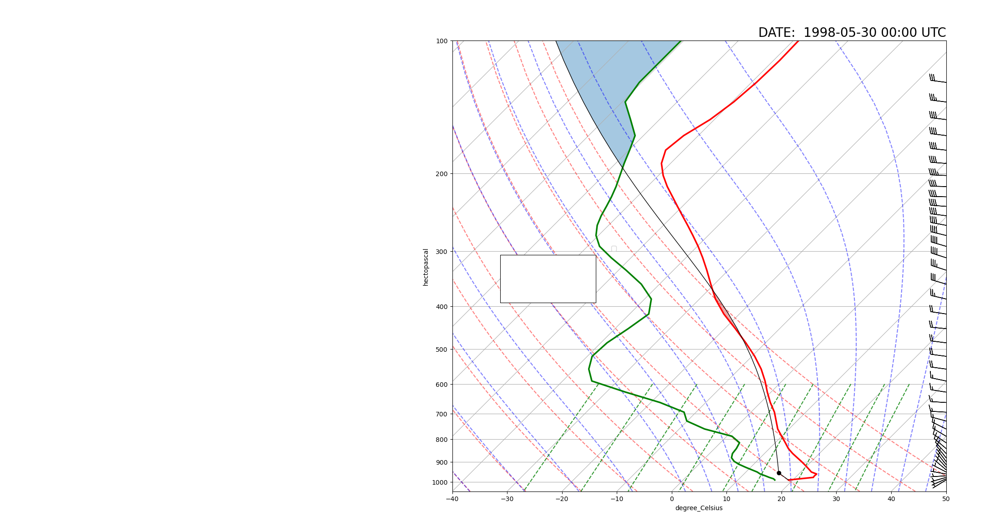

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


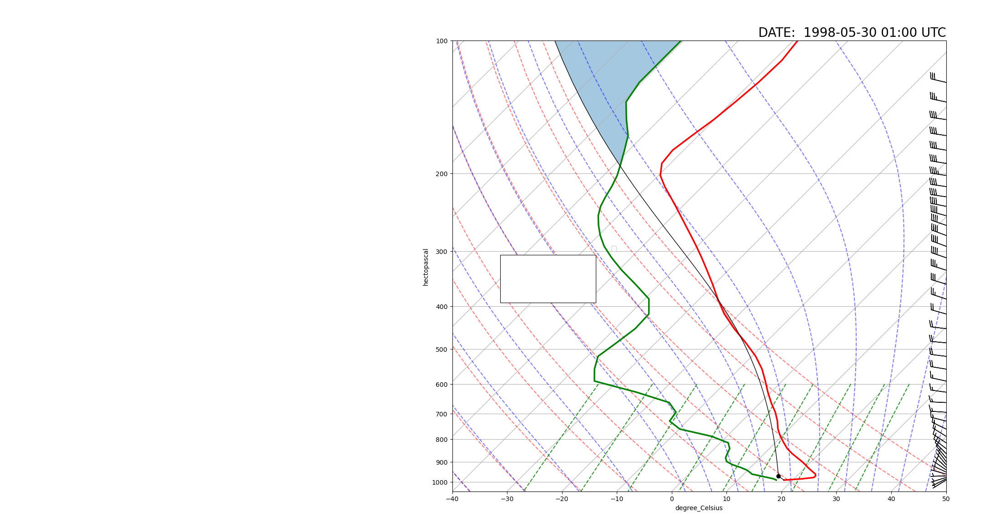

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


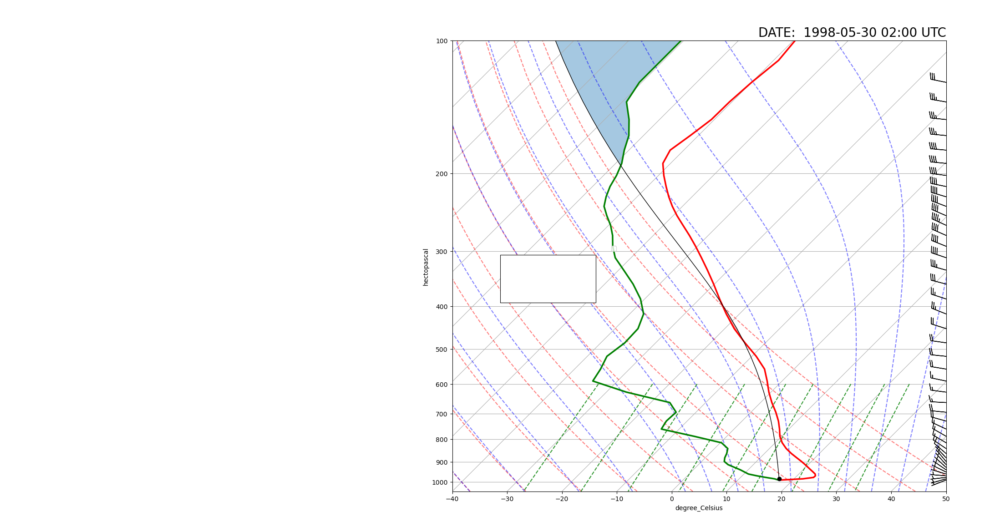

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


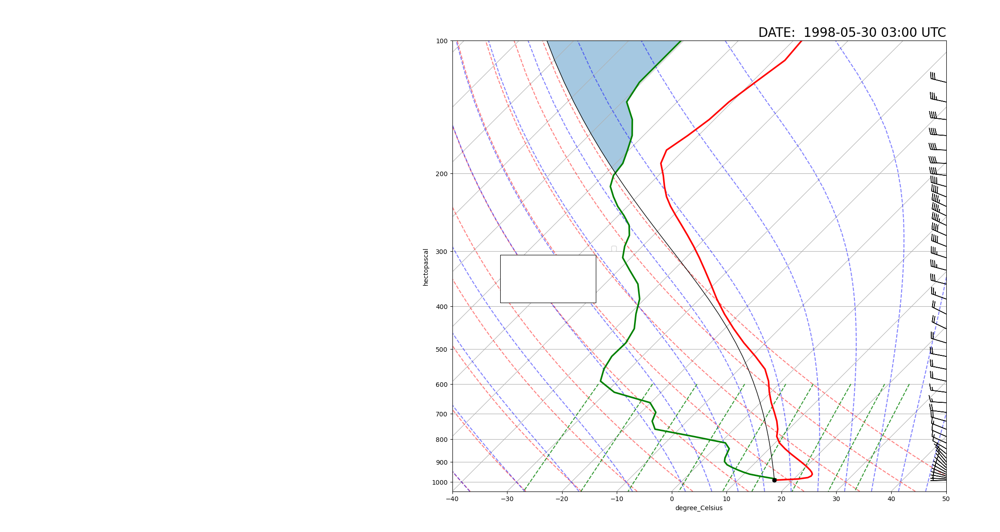

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


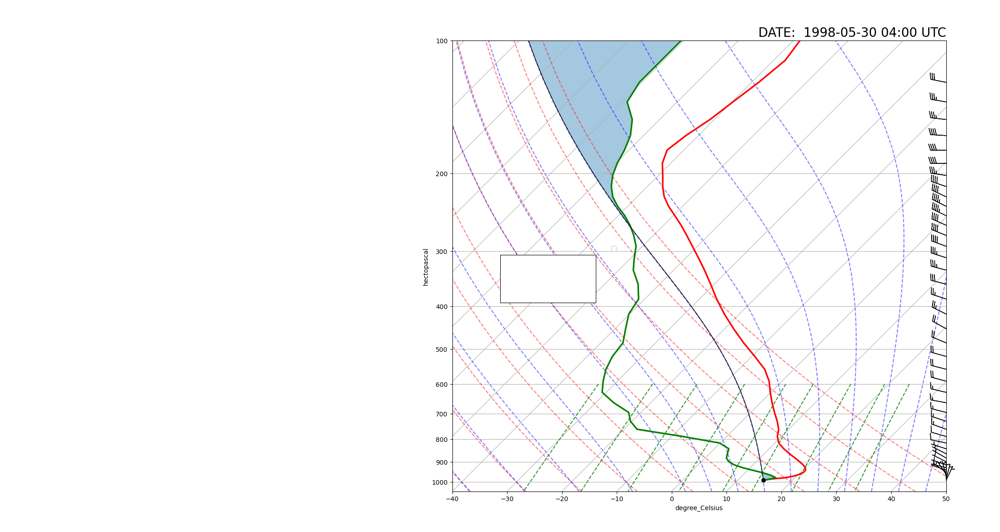

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


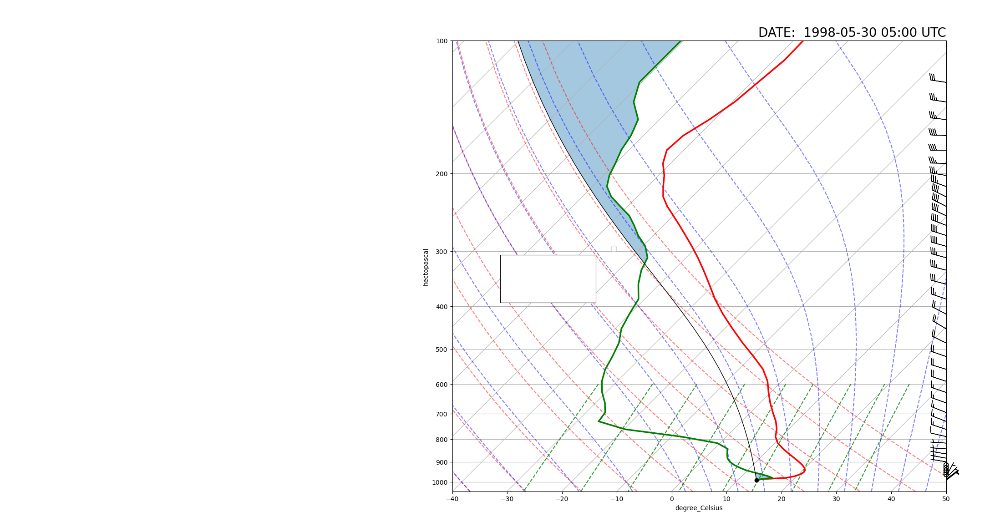

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


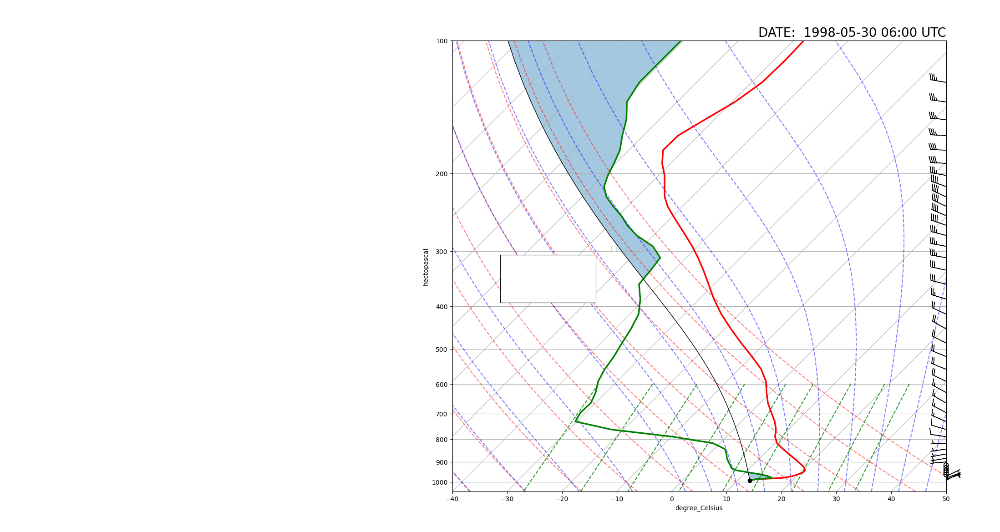

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


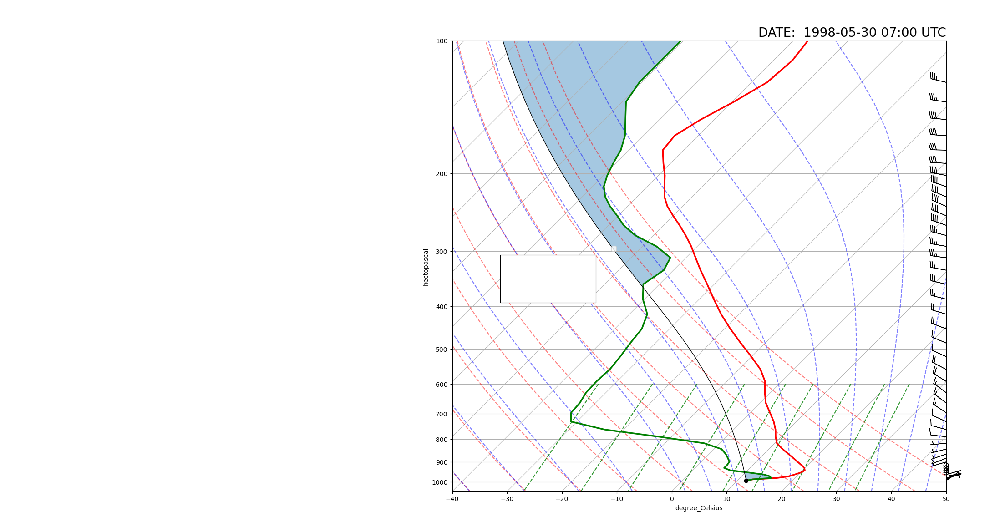

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


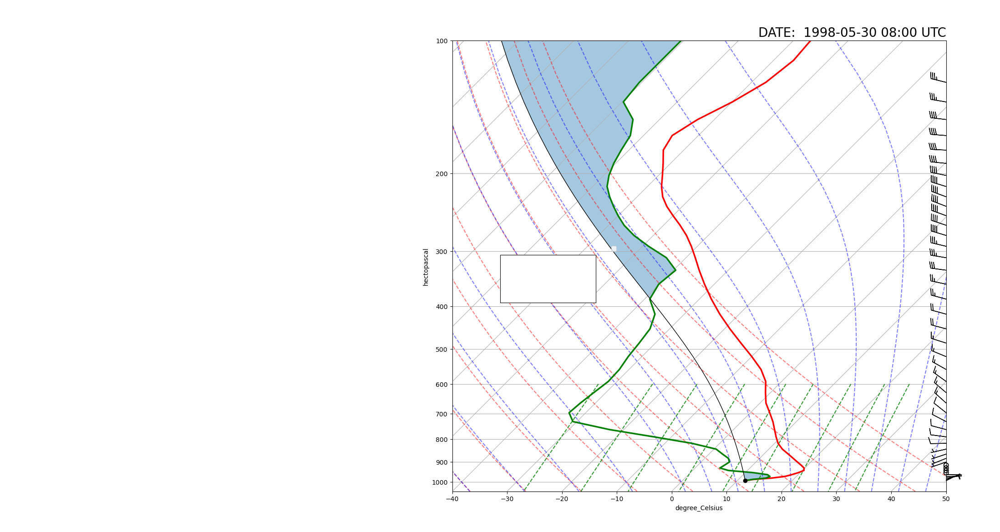

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


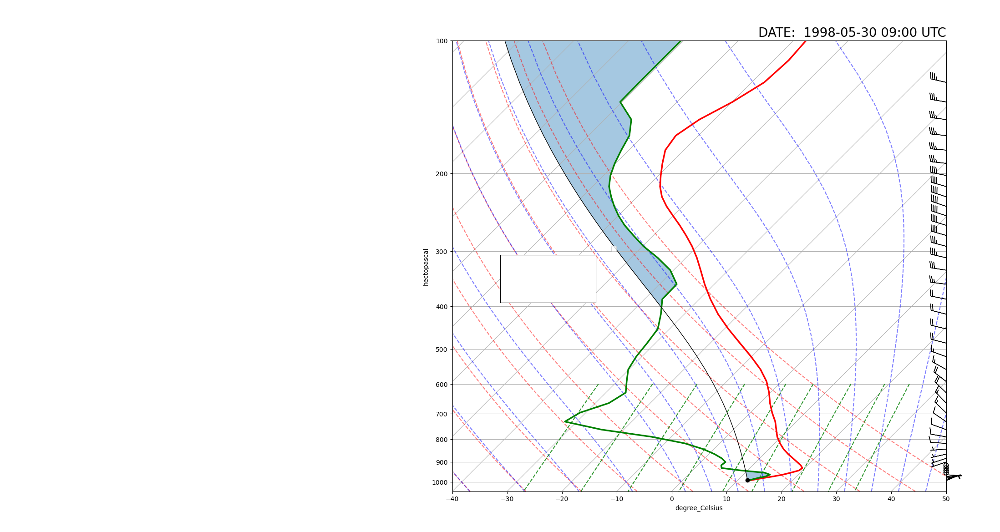


KeyboardInterrupt



Error in callback <function flush_figures at 0x7f22f20d2c00> (for post_execute):



KeyboardInterrupt



In [12]:
for i in range(len(Dean_adjusted)):
    sigma = 5.67 * 10**-8 #Stefon-Boltzman Constant
    
    wrfin = Dataset(Dean_adjusted[i])
    
    wrf_out_data = xr.open_dataset(Dean_adjusted[i])          #Open WRF_Out Data (I sorted glob glob my whole directory)
    
    #Get pertinent values necessary for skew-T
    p1 = wrf.getvar(wrfin,"pressure",timeidx=0)               #Pressure
    T1 = wrf.getvar(wrfin,"tc",timeidx=0)                     #Temperature
    Td1 = wrf.getvar(wrfin,"td",timeidx=0)                    #Dewpoint
    u1 = wrf.getvar(wrfin,"ua",timeidx=0)                     #Zonal Winds
    v1 = wrf.getvar(wrfin,"va",timeidx=0)                     #Meridional Winds
    pot1 = wrf.getvar(wrfin,"th",timeidx=0)                   #potential Temperature
    height1 = wrf.getvar(wrfin,"height_agl",timeidx=0)        #Height above ground level for mass point
    
    #Now that we are done with our textfile, we want to make a nice skew_T:
    p_area =  p1[:,int(X_Y_Sounding_Center[i][1]-5):int(X_Y_Sounding_Center[i][1]+5),int(X_Y_Sounding_Center[i][0]-5):int(X_Y_Sounding_Center[i][0]+5)]   * units.hPa        #Average Pressure in Hpa 
    T_area =  T1[:,int(X_Y_Sounding_Center[i][1]-5):int(X_Y_Sounding_Center[i][1]+5),int(X_Y_Sounding_Center[i][0]-5):int(X_Y_Sounding_Center[i][0]+5)]   * units.degC       #Average Temperature in Degrees Celsius
    Td_area = Td1[:,int(X_Y_Sounding_Center[i][1]-5):int(X_Y_Sounding_Center[i][1]+5),int(X_Y_Sounding_Center[i][0]-5):int(X_Y_Sounding_Center[i][0]+5)]  * units.degC       #Average Dewpoint Temperature in Degrees Celsius
    u_area =  u1[:,int(X_Y_Sounding_Center[i][1]-5):int(X_Y_Sounding_Center[i][1]+5),int(X_Y_Sounding_Center[i][0]-5):int(X_Y_Sounding_Center[i][0]+5)]   * units('m/s')     #Average Zonal Winds in m/s                  
    v_area =  v1[:,int(X_Y_Sounding_Center[i][1]-5):int(X_Y_Sounding_Center[i][1]+5),int(X_Y_Sounding_Center[i][0]-5):int(X_Y_Sounding_Center[i][0]+5)]   * units('m/s')     #Average Meridional winds in m/s
    
    #to take the area average sounding, we need to average (mean) about the S_N and W_E arrays
    p_avg_we = p_area.mean(dim = 'south_north')      #Average out area sounding across the S_n array
    p_avg    = p_avg_we.mean(dim = 'west_east')      #Average our area + S_N average by the W_E so we have a 1d array with pressure levels and values

    #Same for Tempearture
    T_avg_we = T_area.mean(dim = 'south_north')
    T_avg    = T_avg_we.mean(dim = 'west_east')

    #Same For Dewpopint
    Td_avg_we = Td_area.mean(dim = 'south_north')
    Td_avg    = Td_avg_we.mean(dim = 'west_east')

    #Same for zonal wind
    u_avg_we = u_area.mean(dim = 'south_north')
    u_avg    = u_avg_we.mean(dim = 'west_east')

    #Same for meridional wind
    v_avg_we = v_area.mean(dim = 'south_north')
    v_avg    = v_avg_we.mean(dim = 'west_east')
    
    #MetPy skew-T plotting
    fig = plt.figure(figsize = (14,14))
    skew = SkewT(fig, rotation = 45)
    ax1 = skew
    ax1.plot(p_avg, T_avg, 'r', linewidth = 2.5)
    ax1.plot(p_avg, Td_avg, 'g', linewidth = 2.5)
    #ax1.ax.set_ylim(1000,100)
    #ax1.ax.set_xlim(-30,50)
    #ax1.ax.set_xlim(10,35)
    #ax1.ax.set_ylim(1000,750)
    
    ncfile = Dataset(Dean_adjusted[i])
    Time = wrf.extract_times(ncfile, timeidx=0, method='cat', squeeze=True, cache=None, meta=False, do_xtime=False)
    timestr = (str(Time))
    
    titletime=(timestr[0:10]+' '+timestr[11:16])
    filetime=(timestr[0:10]+'_'+timestr[11:13])

    lcl_pressure , lcl_temperature = mpcalc.lcl(p_avg[0], T_avg[0], Td_avg[0])
    ax1.plot(lcl_pressure, lcl_temperature, 'ko', markerfacecolor = 'black')

    #Find LCL Height
    prof = mpcalc.parcel_profile(p_avg, T_avg[0], Td_avg[0]) 
    prof = prof.values - 273.15 
    ax1.plot(p_avg, prof, 'k', linewidth = 1)

    ax1.shade_cin(p_avg.values, Td_avg.values, prof) 
    ax1.shade_cape(p_avg.values, T_avg.values, prof)
    
    # calculate surface based CAPE/CIN
    prof = prof * units.degC  
    cape_cin = mpcalc.cape_cin(p_avg, T_avg, Td_avg, prof)

    #Plot Wind Barbs
    ax1.plot_barbs(p_avg[:-5].values, u_avg[:-5], v_avg[:-5])

    #Plot Skew-T
    ax1.plot_dry_adiabats()
    ax1.plot_moist_adiabats()
    ax1.plot_mixing_lines()

    plt.title(f'DATE: '+' '+titletime+' UTC', loc = 'right', fontsize = 20)
    #plt.title(f'Dean Research Run: Ocean Area Sounding \nSurface Base CAPE ={cape_cin[0]}\nSurface Base CIN ={cape_cin[1]}', loc = 'left', fontsize = 15)

    #Next for valdiation purposes, show the approximate area of the sounding via the code above
    #ax2 = fig.add_axes([0.65, 0.65, 0.2, 0.2], projection=ccrs.PlateCarree())  #Specify the location
    #Eax2 = fig.add_axes([0.2, 0.4, 0.15, 0.15], projection=ccrs.PlateCarree())  #Specify the location
    tclon5a=5*(int(lat_lon_center_of_square[1]/5)-1)
    tclon5b=5*(int(lat_lon_center_of_square[1]/5))
    tclat5a=5*(int(lat_lon_center_of_square[0]/5)-1)
    tclat5b=5*(int(lat_lon_center_of_square[0]/5))
       
    #For Sounding Location
    #lon_i = wrf_out_data['XLONG'][0,X_Y_Sounding_Center[i][1],X_Y_Sounding_Center[i][0]].values
    #lat_i = wrf_out_data['XLAT'][0,X_Y_Sounding_Center[i][1],X_Y_Sounding_Center[i][0]].values
    
    #ax2.plot(lon_i, lat_i, "x", color = '#00B2EE', label = "Center of Area Averaged Sounding")

    #Add square for where we are attempting to take an area average sounding!
    #bottom Left Point of Square:
    #bottom_left = wrf_out_data['XLONG'][0,X_Y_Sounding_Center[i][1]-5, X_Y_Sounding_Center[i][0]-5].values, wrf_out_data['XLAT'][0,X_Y_Sounding_Center[i][1]-5, X_Y_Sounding_Center[i][0]-5].values
    #width = wrf_out_data['XLONG'][0,X_Y_Sounding_Center[i][1]-5, X_Y_Sounding_Center[i][0]+5].values - wrf_out_data['XLONG'][0,X_Y_Sounding_Center[i][1]-5, X_Y_Sounding_Center[i][0]-5].values
    #height = wrf_out_data['XLAT'][0,X_Y_Sounding_Center[i][1]+5, X_Y_Sounding_Center[i][0]-5].values - wrf_out_data['XLAT'][0,X_Y_Sounding_Center[i][1]-5, X_Y_Sounding_Center[i][0]-5].values

    #plt.legend(loc=2, prop={'size': 10})
    #plt.legend(bbox_to_anchor=(.75, .75, 0.5, 0.5))
    plt.show()
    plt.close()